# Исследование объявлений о продаже квартир

    


## Общая информация

**_В вашем распоряжении данные сервиса Яндекс.Недвижимость — архив объявлений о продаже квартир в Санкт-Петербурге и соседних населённых пунктов за несколько лет. Нужно научиться определять рыночную стоимость объектов недвижимости. Ваша задача — установить параметры. Это позволит построить автоматизированную систему: она отследит аномалии и мошенническую деятельность._**

**_По каждой квартире на продажу доступны два вида данных. Первые вписаны пользователем, вторые — получены автоматически на основе картографических данных. Например, расстояние до центра, аэропорта, ближайшего парка и водоёма._** 

In [1]:
import plotly.express as px
import pandas as pd
pd.set_option('display.max_columns', None)

In [2]:
try:
    real_estate = pd.read_csv('D:/YP_DS/real_estate_data.csv', sep='\t')
except:
    real_estate = pd.read_csv(
        'https://code.s3.yandex.net/datasets/real_estate_data.csv', sep='\t')

display(real_estate.head(15))  # Вызовем первые 15 строк датасета

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.00,2019-03-07T00:00:00,3,2.70,16.0,51.00,8,NaN,False,False,25.00,NaN,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.40,2018-12-04T00:00:00,1,NaN,11.0,18.60,1,NaN,False,False,11.00,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.00,2015-08-20T00:00:00,2,NaN,5.0,34.30,4,NaN,False,False,8.30,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.00,2015-07-24T00:00:00,3,NaN,14.0,NaN,9,NaN,False,False,NaN,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.00,2018-06-19T00:00:00,2,3.03,14.0,32.00,13,NaN,False,False,41.00,NaN,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0
5,10,2890000.0,30.40,2018-09-10T00:00:00,1,NaN,12.0,14.40,5,NaN,False,False,9.10,NaN,городской посёлок Янино-1,NaN,NaN,NaN,NaN,NaN,NaN,55.0
6,6,3700000.0,37.30,2017-11-02T00:00:00,1,NaN,26.0,10.60,6,NaN,False,False,14.40,1.0,посёлок Парголово,52996.0,19143.0,0.0,NaN,0.0,NaN,155.0
7,5,7915000.0,71.60,2019-04-18T00:00:00,2,NaN,24.0,NaN,22,NaN,False,False,18.90,2.0,Санкт-Петербург,23982.0,11634.0,0.0,NaN,0.0,NaN,NaN
8,20,2900000.0,33.16,2018-05-23T00:00:00,1,NaN,27.0,15.43,26,NaN,False,False,8.81,NaN,посёлок Мурино,NaN,NaN,NaN,NaN,NaN,NaN,189.0
9,18,5400000.0,61.00,2017-02-26T00:00:00,3,2.50,9.0,43.60,7,NaN,False,False,6.50,2.0,Санкт-Петербург,50898.0,15008.0,0.0,NaN,0.0,NaN,289.0




- `airports_nearest` — расстояние до ближайшего аэропорта в метрах (м)
- `balcony` — число балконов
- `ceiling_height` — высота потолков (м)
- `cityCenters_nearest` — расстояние до центра города (м)
- `days_exposition` — сколько дней было размещено объявление (от публикации до снятия)
- `first_day_exposition` — дата публикации
- `floor` — этаж
- `floors_total` — всего этажей в доме
- `is_apartment` — апартаменты (булев тип)
- `kitchen_area` — площадь кухни в квадратных метрах (м²)
- `last_price` — цена на момент снятия с публикации
- `living_area` — жилая площадь в квадратных метрах (м²)
- `locality_name` — название населённого пункта
- `open_plan` — свободная планировка (булев тип)
- `parks_around3000` — число парков в радиусе 3 км
- `parks_nearest` — расстояние до ближайшего парка (м)
- `ponds_around3000` — число водоёмов в радиусе 3 км
- `ponds_nearest` — расстояние до ближайшего водоёма (м)
- `rooms` — число комнат
- `studio` — квартира-студия (булев тип)
- `total_area` — общая площадь квартиры в квадратных метрах (м²)
- `total_images` — число фотографий квартиры в объявлении

In [3]:
real_estate.info() #Посмотрим информацию о столбцах для выявления пропусков

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        14504 non-null  float64
 6   floors_total          23613 non-null  float64
 7   living_area           21796 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          2775 non-null   object 
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          21421 non-null  float64
 13  balcony               12180 non-null  float64
 14  locality_name         23650 non-null  object 
 15  airports_nearest   



Применив метод info() к нашему датасету можно увидеть что пропуски имеются в следующих столбцах:
 - `ceiling_height`:
    Пропуски в этом столбце связаны с тем, что не каждый арендодатель указывает высоту потолков в сервисе.
 - `floors_total`:
    Аналогичная причина, почти все значения заполнены, но несколько позиций пропущено либо по желанию человека, либо из-за человеческого фактора.
    Дополнительно можно подметить, что данный столбец имеет неверный тип данных float64, вместо int64.
 - `living_area`:
    Имеет небольшое кол-во пропусков.Причина пропуска - Человеческий фактор или желание человека не заполнять данную позицию в сервисе.
 - `is_apartment`:
    Здесь имеется большое количество пропусков, но это и имеет смысл. Вероятнее всего те значения, где стоит пропуск означают, что это `НЕ` апартаменты и имеет смысл заменить их на `False`.
    Дополнительно можно отметить, что в этом столбце не будет никаких значений, кроме как `True` и `False`, поэтому можно изменить тип данных на `bool`
 - `kitchen_area`:
    Имеет небольшое кол-во пропусков.Причина пропуска - Человеческий фактор или желание человека не заполнять данную позицию в сервисе.
 - `balcony`:
    Если продавец не указал число балконов, то, скорее всего, в его квартире их нет. Такие пропуски правильно заменить на 0.
 - `locality_name`:
    Имеет небольшое кол-во пропусков.Причина пропуска - Человеческий фактор или желание человека не заполнять данную позицию в сервисе.
 - `airports_nearest`:
    Здесь пропуски значений могут быть связаны  с тем, что его нет рядом
    Вероятнее всего есть некая зависимость между расстоянием до аэропорта и типом населённого пункта.
    Например если это будет посёлок, то и аэропорта там может и не быть рядом отсюда и вылезает пропуск.
 - `cityCenters_nearest`:
    Здесь пропуски значений могут быть связаны с тем, что и в предыдущем пункте. Например если это посёлок, а не город, то и расстояние до его центра будет отсутствовать.
 - `parks_around3000`:
    Пропущенные значения в этом столбце могут быть связаны с тем, что типом населённого пункта может быть посёлок и там не будет существовать парка.
 - `parks_nearest`:
    Пропущенные значения в этом столбце могут быть связаны с тем, что типом населённого пункта может быть посёлок и там не будет существовать парка.
    Либо, если это город, то парк может быть на большой дистанции и значение будет заполняться как отсутствующее.
 - `pounds_around3000`:
     Пропущенные значения в этом столбце могут быть связаны с тем, что типом населённого пункта может быть посёлок и там не будет существовать водоёма.
 - `pounds_nearest`:
     Пропущенные значения в этом столбце могут быть связаны с тем, что типом населённого пункта может быть посёлок и там не будет существовать водоёма.
     Либо, если это город, то водоём может быть на большой дистанции и значение будет заполняться как отсутствующее.
 - `days_exposition`:
     Вероятнее всего это техническая ошибка или баг, ведь в столбце `first_day_exposition` нет пропусков, следовательно длительность размещения объявления должно всегда существовать.

In [4]:
df_old_shape = real_estate.shape[0] #Кол-во строк исходного датасета

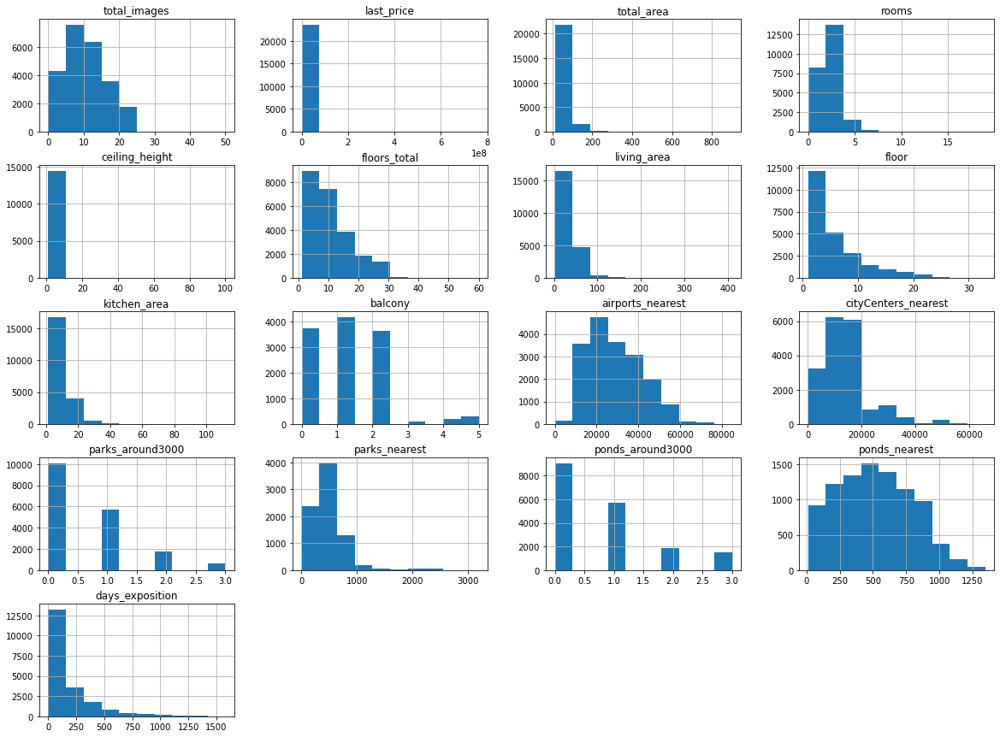

In [5]:
real_estate.hist(figsize=(20,15));

## Предобработка данных

In [6]:
real_estate['first_day_exposition'] = pd.to_datetime(real_estate['first_day_exposition'])
real_estate['first_day_exposition'].head()

#Необходимо изменить тип данных данного столбца на datetime64

0   2019-03-07
1   2018-12-04
2   2015-08-20
3   2015-07-24
4   2018-06-19
Name: first_day_exposition, dtype: datetime64[ns]

In [7]:
#Заполним пропущенные значения в столбце медидианным значением 
real_estate['ceiling_height'].fillna(value=real_estate['ceiling_height'].median(),inplace=True)

In [8]:
real_estate['is_apartment'].fillna(False,inplace = True)
real_estate['is_apartment'].astype(bool) 
#Заполним пропуски в столбце 'is_apartment'.
#Изменим все пропущенные значения на False

0        False
1        False
2        False
3        False
4        False
         ...  
23694    False
23695    False
23696    False
23697    False
23698    False
Name: is_apartment, Length: 23699, dtype: bool

In [9]:
real_estate['balcony'].fillna(0, inplace=True)
real_estate['balcony'].astype(int)
# Заполним пропуски в столбце 'balcony'.
# Изменим все пропущенные значения на 0

0        0
1        2
2        0
3        0
4        0
        ..
23694    0
23695    0
23696    0
23697    2
23698    0
Name: balcony, Length: 23699, dtype: int32

In [10]:
#Заполним пропуски в столбце 'floors_total'.
real_estate['floors_total'].fillna(real_estate['floor'],inplace = True)

In [11]:
# Посчитаем коэффициент отношения жилой площади к общей площади
area_room_ratio = real_estate['living_area'].mean()/real_estate['total_area'].mean()

# Заменим пропущенные значения умножив коэффициент на каждое значение общей площади
real_estate['living_area'].fillna(
    area_room_ratio*real_estate['total_area'], inplace=True)

In [12]:
# Посчитаем коэффициент отношения жилой площади к общей площади
area_kitchen_ratio = real_estate['kitchen_area'].mean()/real_estate['total_area'].mean()

# Заменим пропущенные значения умножив коэффициент на каждое значение общей площади
real_estate['kitchen_area'].fillna(
    area_kitchen_ratio*real_estate['total_area'], inplace=True)



Проанализировав данные о датасете, можно увидеть, что нужно изменить тип данных в следующих столбцах:
 - `first_day_exposition` (`object` -> `datetime`):
          Данный тип данных следует изменить с `object` на `datetime`. Так как в нём хранятся 
          только  значения даты.
 - `is_apartment` (`object` -> `bool`):
          Данный тип данных следует изменить с `object` на `bool`. Так как в нём хранятся только булевы значения. Но чтобы изменить тип данных на другой, нам нужно заполнить все пропуски.
     
 - `balcony` (`float64` -> `int64`):
         Данный тип данных следует изменить с `float` на `integer`. Так как в нём хранятся только целые значения.
 - `floors_total`:
         Заменим пропущенные данные значениями столбца floor исходя из того, что этот этаж будет являться последним
 - `living_area`:
         Заменим пропущенные данные значениями через коэффициент отношения жилой площади к общей площади.
         Жилая площадь(среднее)/Общая площадь(среднее)*Общая площадь одного объявления
 - `kitchen_area`:
         Заменим пропущенные данные значениями через коэффициент отношения площади кухни к общей площади.
         Площадь кухни(среднее)/Общая площадь(среднее)*Общая площадь одного объявления

# Предобработка данных (поиск неявных дубликатов)

In [13]:
real_estate = real_estate.loc[real_estate['locality_name'].isna() == False].reset_index(drop=True)
# Избавляемся от пропусков в столбце 'locality_name' отсортировав его методом .isna() == False

unique_names = sorted(real_estate['locality_name'].astype(str).unique())
# Получим уникальные названия в столбце и отсортируем их для более удобного анализа
display(unique_names)

['Бокситогорск',
 'Волосово',
 'Волхов',
 'Всеволожск',
 'Выборг',
 'Высоцк',
 'Гатчина',
 'Зеленогорск',
 'Ивангород',
 'Каменногорск',
 'Кингисепп',
 'Кириши',
 'Кировск',
 'Колпино',
 'Коммунар',
 'Красное Село',
 'Кронштадт',
 'Кудрово',
 'Лодейное Поле',
 'Ломоносов',
 'Луга',
 'Любань',
 'Мурино',
 'Никольское',
 'Новая Ладога',
 'Отрадное',
 'Павловск',
 'Петергоф',
 'Пикалёво',
 'Подпорожье',
 'Приморск',
 'Приозерск',
 'Пушкин',
 'Санкт-Петербург',
 'Светогорск',
 'Сертолово',
 'Сестрорецк',
 'Сланцы',
 'Сосновый Бор',
 'Сясьстрой',
 'Тихвин',
 'Тосно',
 'Шлиссельбург',
 'городской поселок Большая Ижора',
 'городской поселок Янино-1',
 'городской посёлок Будогощь',
 'городской посёлок Виллози',
 'городской посёлок Лесогорский',
 'городской посёлок Мга',
 'городской посёлок Назия',
 'городской посёлок Новоселье',
 'городской посёлок Павлово',
 'городской посёлок Рощино',
 'городской посёлок Свирьстрой',
 'городской посёлок Советский',
 'городской посёлок Фёдоровское',
 'городск

Проанализировав список уникальных местоположений можно заметить такие неявные дубликаты как: `поселок Рябово` и `поселок городского типа Рябово`, и тд.

Поэтому создадим функцию-фильтр, которую применим к нашему `Series('locality_name')`

In [14]:
def renamer(column):
    if 'поселок' in column or 'посёлок' in column:
        # Изменяет название на (посёлок + исходное название)
        return 'посёлок ' + column.split()[-1]
    else:
        return column  # Возвращает строку, которая и была раньше

Заменим все неявные дубликаты в исходном столбце

In [15]:
real_estate['locality_name'] = real_estate['locality_name'].apply(renamer)
real_estate.head(5)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.0,2019-03-07,3,2.70,16.0,51.000000,8,False,False,False,25.000000,0.0,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.4,2018-12-04,1,2.65,11.0,18.600000,1,False,False,False,11.000000,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.0,2015-08-20,2,2.65,5.0,34.300000,4,False,False,False,8.300000,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.0,2015-07-24,3,2.65,14.0,90.785766,9,False,False,False,27.848168,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.0,2018-06-19,2,3.03,14.0,32.000000,13,False,False,False,41.000000,0.0,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0


## Предобработка данных (анализ аномальных значений)


### Выведем гистограммы для каждого количественного столбца и проанализируем данные

In [16]:
px.histogram(x=real_estate['total_images'], nbins=100,text_auto = True, title='Число фотографий квартиры', labels= {'x':'Число фотографий'}).show(renderer='notebook')

**_Характерные выбивающиеся значения на данной гистограмме можно увидеть лишь после значения > 20. Таких значений не очень много, поэтому их можно удалить_**

In [17]:
real_estate = real_estate.loc[real_estate['total_images'] <= 20].reset_index(drop = True)
#Удаляем значения кол-во которых больше 20


In [18]:
px.histogram(x=real_estate['last_price'], nbins=20, text_auto=True,title='Цена на момент снятия публикации', labels= {'x':'Цена'},width= 800)

**_Характерные выбивающиеся значения на данной гистограмме можно увидеть лишь после значения > 50M. Таких значений не очень много, поэтому их можно удалить_**


In [19]:
real_estate = real_estate.loc[real_estate['last_price'] <= 50000000].reset_index(drop = True)
#Удаляем значения кол-во которых больше 50M

In [20]:
px.histogram(x=real_estate['total_area'], nbins=20, title='Общая площадь квартиры', text_auto=True, labels= {'x':'Площадь'},width= 800)

**_Характерные выбивающиеся значения на данной гистограмме можно увидеть лишь после значения > 200, либо < 15. Таких значений не очень много, поэтому для более точного анализа их можно удалить_**

In [21]:
real_estate = real_estate.loc[(real_estate['total_area'] <= 200) & (real_estate['total_area'] >= 15)].reset_index(drop = True)
#Удаляем значения кол-во которых больше 200 и меньше 15

In [22]:
px.histogram(x=real_estate['rooms'], nbins=20, title='Количество комнат', text_auto=True, labels= {'x':'Комнаты'},width= 800)

**_Характерные выбивающиеся значения на данной гистограмме можно увидеть лишь после значения > 7. Таких значений не очень много, поэтому для более точного анализа их можно удалить.
Кол-во комнат , где их количество равно нулю похожи на аномальные значения, но лучше проверим это:_**

In [23]:
real_estate.query('rooms == 0').head()

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
142,1,2450000.0,27.00,2017-03-30,0,2.65,24.0,15.500000,2,False,True,False,4.728934,2.0,посёлок Мурино,NaN,NaN,NaN,NaN,NaN,NaN,181.0
345,4,2320000.0,25.00,2017-09-27,0,2.65,14.0,17.000000,1,False,False,True,4.378643,0.0,деревня Кудрово,NaN,NaN,NaN,NaN,NaN,NaN,45.0
436,8,2480000.0,27.11,2018-03-12,0,2.65,17.0,24.750000,4,False,True,False,4.748200,2.0,Санкт-Петербург,38171.0,15015.0,0.0,NaN,2.0,982.0,64.0
502,0,3375000.0,34.40,2017-03-28,0,2.65,26.0,24.300000,19,False,False,True,6.025012,1.0,посёлок Парголово,53115.0,19292.0,0.0,NaN,1.0,593.0,430.0
599,2,1850000.0,25.00,2019-02-20,0,2.65,10.0,14.274492,7,False,True,False,4.378643,0.0,посёлок Шушары,NaN,NaN,NaN,NaN,NaN,NaN,29.0


**_Да, это выбившееся значение. Удалим его, так как 195 комнат состовляет небольшой процент от общего кол-ва комнат_**

In [24]:
real_estate['rooms'].replace(0,1, inplace=True) #Заменяем все комнаты значения которых равно нулю на единицу

real_estate = real_estate.loc[(real_estate['rooms'] <= 7)].reset_index(drop = True)
#Удаляем значения кол-во которых больше 7


In [25]:
px.histogram(x=real_estate['ceiling_height'], nbins=100, title='Высота потолков', text_auto=True, labels= {'x':'Высота'},range_x=(0,40))



**_Анализируя данную гистограмму можно увидеть, что у нас есть три типа аномальных значений:_**
 - Значения высоты потолков больше 20м (данные значения похоже на аномалию и их можно заменить поделив эти значения на 10)
 - Значения высоты потолков меньше 2м
 - Значения высоты потолков больше 5м
 

In [26]:
real_estate.loc[real_estate['ceiling_height'] >= 20,'ceiling_height'] = real_estate['ceiling_height']/10
#Изменяем значения потолков, чья высота больше 20 путём деления самого себя на 10

real_estate = real_estate.loc[(real_estate['ceiling_height'] > 2) & (real_estate['ceiling_height'] < 5)].reset_index(drop = True)
#Удалим редкие значения из столбца

In [27]:
px.histogram(x=real_estate['floors_total'], nbins=100, title='Количество этажей', text_auto=True, labels= {'x':'Этажи'})

**_Характерные выбивающиеся значения на данной гистограмме можно увидеть лишь после значения > 28. Таких значений не очень много, поэтому для более точного анализа их можно удалить._**

In [28]:
real_estate = real_estate.loc[(real_estate['floors_total'] <= 28)].reset_index(drop = True)
#Удалим редкие значения из столбца

In [29]:
px.histogram(x=real_estate['living_area'], nbins=100, title='Жилая площадь', text_auto=True, labels= {'x':'Площадь'})

In [30]:
real_estate = real_estate.loc[(real_estate['living_area'] >= 8)].reset_index(drop = True)
#Удалим редкие значения из столбца

**_Есть несколько выбивающихся значений при < 8. Удалим их для борее корректного анализа данных_**

In [31]:
px.histogram(x=real_estate['floor'], nbins=30, title='Этаж', text_auto=True, labels= {'x':'Этаж'})

**_Здесь нет аномальных значений. Так как мы отредактировали столбец с общим количеством этажей. Но лучше перестраховаться :)_**

In [32]:
px.histogram(x=real_estate['kitchen_area'], nbins=20, title='Площадь кухни', text_auto=True, labels= {'x':'Площадь'})

In [33]:
real_estate = real_estate.loc[(
    real_estate['kitchen_area'] >= 2.5)].reset_index(drop=True)

**_Есть несколько рекдих значений при < 2.5 . Поэтому удалим их для более корректного анализа
Последующие данные в таблице заполнялись картогрофическим путём поэтому корректировать данные там не нужно._**

In [34]:
print('Процент отброшенных значений:', str(round(100 - real_estate.shape[0]/df_old_shape*100,2))+'%')

Процент отброшенных значений: 2.04%


## Добавление новых столбцов в таблицу

In [35]:
real_estate.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23216 entries, 0 to 23215
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   total_images          23216 non-null  int64         
 1   last_price            23216 non-null  float64       
 2   total_area            23216 non-null  float64       
 3   first_day_exposition  23216 non-null  datetime64[ns]
 4   rooms                 23216 non-null  int64         
 5   ceiling_height        23216 non-null  float64       
 6   floors_total          23216 non-null  float64       
 7   living_area           23216 non-null  float64       
 8   floor                 23216 non-null  int64         
 9   is_apartment          23216 non-null  bool          
 10  studio                23216 non-null  bool          
 11  open_plan             23216 non-null  bool          
 12  kitchen_area          23216 non-null  float64       
 13  balcony         

In [36]:
real_estate['square_price'] = real_estate['last_price']/real_estate['total_area'] #Цена одного м2
real_estate['first_day_exposition_name'] = real_estate['first_day_exposition'].dt.weekday #день недели публикации объявления (0 — понедельник, 1 — вторник и так далее)
real_estate['first_month_exposition_name'] = real_estate['first_day_exposition'].dt.month #месяц публикации
real_estate['first_year_exposition_name'] = real_estate['first_day_exposition'].dt.year #год публикации

In [37]:
real_estate['type_floor'] = real_estate['floor'].where(real_estate['floor'] != real_estate['floors_total'], 'последний')
#Категоризируем данные последних этажей

In [38]:
#Создадим функцию сортировщик, которая отфильтрует первые и остальные этажи
def flat_type(column):
    if column == 1:
        return 'первый'
    elif column == 'последний':
        return 'последний'
    else:
        return 'другой'
    

In [39]:
#Применим функцию к категориальному столбцу type_floor
real_estate['type_floor'] = real_estate['type_floor'].apply(flat_type)

In [40]:
#Переведем расстояние до центра города из метров в километры и округлим значение до целого числа
real_estate['cityCenters_nearest'] = real_estate['cityCenters_nearest'].where(real_estate['cityCenters_nearest'].isna() == True, round(real_estate['cityCenters_nearest']/1000))

## Исследовательский анализ данных



**_Изучим следующие параметры объектов:_**
 - общая площадь;
 - жилая площадь;
 - площадь кухни;
 - цена объекта;
 - количество комнат;
 - высота потолков;
 - этаж квартиры;
 - тип этажа квартиры («первый», «последний», «другой»);
 - общее количество этажей в доме;
 - расстояние до центра города в метрах;
 - расстояние до ближайшего аэропорта;
 - расстояние до ближайшего парка;
 - день и месяц публикации объявления.


In [41]:
px.histogram(x=real_estate['total_area'], nbins=20, text_auto=True, title='Общая площадь', labels= {'x':'Площадь'},)

**_По гистограмме видно, что наиболее распространённая общая площадь кваритры находится в промежутке от 25...65 [м2]_**

In [42]:
px.histogram(x=real_estate['living_area'], nbins=20,
             text_auto=True, title='Жилая площадь', labels={'x': 'Площадь'})

**_По гистограмме видно, что наиболее распространённая жилая площадь кваритры находится в промежутке от 10...50 [м2]_**

In [43]:
px.histogram(x=real_estate['kitchen_area'], nbins=20, text_auto=True, title='Площадь кухни', labels= {'x':'Площадь'})

**_По гистограмме видно, что наиболее распространённая площадь кухни находится в промежутке от 2.5...12.5 [м2]_**

In [44]:
px.histogram(x=real_estate['last_price'], nbins=20, text_auto=True, title='Цена объекта', labels= {'x':'Цена'})

**_По гистограмме видно, что больше всего квартир на рынке с ценой до 10 млн.руб_**

In [45]:
px.histogram(x=real_estate['rooms'], nbins=10, text_auto=True, title='Количество комнат', labels= {'x':'Площадь'},width= 800)

**_По гистограмме видно, что больше всего квартир c количеством комнат до 3-х штук_**

In [46]:
px.histogram(x=real_estate['ceiling_height'], nbins=10, text_auto=True, title='Высота потолков', labels= {'x':'Площадь'},range_x=(2.25,5),width= 800)

**_По гистограмме видно, что больше всего квартир c площадью потолков до 3 [м]_**

In [47]:
px.histogram(x=real_estate['floor'], nbins=40, text_auto=True, title='Этаж квартиры', labels= {'x':'Этаж'},width= 800)

**_По гистограмме видно, что чаще всего продают квартиры , которые находятся на 5 этаже или ниже_**

In [48]:
px.histogram(x=real_estate['type_floor'], nbins=20, text_auto=True, title='Тип этажа квартиры', labels= {'x':' '},width= 800)

**_По гистограмме видно, что кол-во квартир на первом и последнем этаже примерно одинаково._**

In [49]:
px.histogram(x=real_estate['floors_total'], nbins=30, text_auto=True, title='Общее количество этажей', labels= {'x':'Этажи'})

**_По гистограмме видно, что объявление о продаже квартиры чаще всего выставляют в 5-этажных, 9-этажных домах, так как это самое распространенное кол-во этажей в здании_**

In [50]:
px.histogram(x=real_estate['cityCenters_nearest'], nbins=20, text_auto=True, title='Расстояние до центра города', labels= {'x':'Расстояние [Км]'},width= 800)

**_По гистограмме видно, что в среднем больше всего квартир с расстоянием до центра от 5...19 [км]_**

In [51]:
px.histogram(x=real_estate['airports_nearest'], nbins=30, text_auto=True, title='Расстояние до ближайшего аэропорта', labels= {'x':'Расстояние [М]'})

**_По гистограмме видно, что расстояние до аэропорта от квартиры в среднем от 10...50 [км]_**

In [52]:
px.histogram(x=real_estate['parks_nearest'], nbins=30, text_auto=True, title='Расстояние до ближайшего парка', labels= {'x':'Расстояние [М]'})

**_По гистограмме видно, что расстояние до ближайшего парка в среднем от 200...800 [м]_**

In [53]:
px.histogram(x=real_estate['first_day_exposition_name'], nbins=10, text_auto=True, title='День публикации объявления', labels= {'x':'День'},width= 800)

**_По гистограмме видно, что чаще всего объявления выставляю по будням. Это логично, ведь чаще всего этим занимаются риэлторские компании, сотрудники которых отдыхают в выходные дни_**

In [54]:
px.histogram(x=real_estate['first_month_exposition_name'], nbins=20, text_auto=True, title='Месяц публикации объявления', labels= {'x':'Месяц'},width= 800)

**_По гистограмме видно, что "просадки" количества объявлений связаны с месяцами, где больше всего праздников и отдыха (такие месяцы как : 1 и 12 "Празничные месяцы", 5 "Майские праздники", 6-8 "Лето")_**

In [55]:
px.histogram(x=real_estate['first_year_exposition_name'], nbins=10, text_auto=True, title='Год публикации объявления', labels= {'x':'Год'},width= 800)

**_Наибольшее кол-во продаж зафиксировано в 2017 и 2018 год_**

## Изучим как быстро продавались квартиры

In [56]:
px.histogram(x=real_estate['days_exposition'], nbins=30, text_auto=True, title='Количество дней объявления', labels= {'x':'Дни'})

In [57]:
real_estate['days_exposition'].describe() #Применим метод describe к нашему столбцу, чтобы увидеть значения среднего арифметического и медианы

count    20114.000000
mean       179.704634
std        218.572634
min          1.000000
25%         45.000000
50%         95.000000
75%        229.000000
max       1580.000000
Name: days_exposition, dtype: float64

**_В среднем квартиры продаются за ~100 дней( 3 месяца) это можно хорошо видеть по медианному значению столбца.
 Это можно считать довольно быстрой продажей. Продажи превосходящее это число можно считать долгими_**

## Влияние факторов на стоимость объекта



**_Изучим, зависит ли цена от:_**
 - общей площади;
 - жилой площади;
 - площади кухни;
 - количества комнат;
 - этажа, на котором расположена квартира (первый, последний, другой);
 - даты размещения (день недели, месяц, год).

Проверим зависит ли цена от общей площади жилья:

In [58]:
area_price_corr = real_estate['total_area'].corr(
    real_estate['last_price'])  # Находим корреляцию общей площади от цены
print('Имеем неплохую положительную корреляцию:', area_price_corr)

px.scatter(real_estate, x='last_price', y='total_area', opacity=0.3, trendline='ols',
           trendline_color_override='red', labels={'last_price': 'Цена', 'total_area': 'Общая площадь'}, width=800)
# Строим точенчную диаграмму и выведем линию тренда для более визуального восприятия зависимости

Имеем неплохую положительную корреляцию: 0.7638628082616347


**_С помощью коэффициента корреляции и графика можно утвердить , что с увеличением общей площади квартиры растёт и её цена_**

Проверим зависит ли цена от жилой площади жилья:

In [59]:
liv_area_price_corr = real_estate['living_area'].corr(real_estate['last_price'])#Находим корреляцию жилой площади от цены
print('Имеем неплохую положительную корреляцию:' ,liv_area_price_corr)

px.scatter(real_estate,x='last_price', y='living_area',opacity=0.3,trendline='ols',trendline_color_override='red', labels= {'last_price':'Цена','living_area':'Жилая площадь'},width= 800)
#Строим точенчную диаграмму и выведем линию тренда для более визуального восприятия зависимости

Имеем неплохую положительную корреляцию: 0.6580068928040925


**_С помощью коэффициента корреляции и графика можно утвердить , что с увеличением жилой площади квартиры растёт и её цена_**

Проверим зависит ли цена от площади кухни:

In [60]:
kitchen_area_price_corr = real_estate['kitchen_area'].corr(real_estate['last_price']) #Находим корреляцию площади кухни от цены
print('Имеем немного меньшую корреляцию,чем в предыдущих случаях:' ,kitchen_area_price_corr)

px.scatter(real_estate,x='last_price', y='kitchen_area',opacity=0.1,trendline='ols',trendline_color_override='red', labels= {'last_price':'Цена','kitchen_area':'Площадь кухни'},width= 800)

Имеем немного меньшую корреляцию,чем в предыдущих случаях: 0.6059976657352124


**_С помощью коэффициента корреляции и графика можно утвердить , что с увеличением жилой площади кухни растёт и её цена_**

Проверим зависит ли цена от количества комнат:

In [61]:
print('Имеем небольшую корреляцию:' ,real_estate['rooms'].corr(real_estate['last_price']))

px.density_heatmap(real_estate,x='last_price', y='rooms', labels= {'last_price':'Цена','rooms':'Количество комнат'},width= 800)
#Строим график хитмэпа зависимости цены от кол-ва комнат

Имеем небольшую корреляцию: 0.46912022847010804


**_Из коэффициента корреляции и графика можно понять, что зависимость не слишком большая, но тем не менее она есть - чем больше комнат, тем выше цена_** 

Проверим зависит ли цена от этажа на котором расположена квартира:

In [62]:
pivot_floor = real_estate.pivot_table(values='last_price',index = 'type_floor',aggfunc=('mean','median'))
display(pivot_floor)
#Создадим сводную таблицу куда поместим осредненные значения цены в зависимости от типа этажа и построим столбчатую диаграмму

px.bar(pivot_floor, x=pivot_floor.index, y="mean",labels={'type_floor':' ','mean':'Средняя цена'},width= 800)
#Построим столбчатую диаграмму зависимости типа этажа от медианного значения цены квартиры

,mean,median
type_floor,,
другой,6.118787e+06,4800000.0
первый,4.578826e+06,3900000.0
последний,5.578439e+06,4250000.0


**_По столбчатой диаграмме можно сделать вывод, что цена квартиры не зависит от её этажа в доме_**

Проверим зависит ли цена от дня размещения объявления:

In [63]:
pivot_day = real_estate.pivot_table(values='last_price',index = 'first_day_exposition_name',aggfunc=('mean','median'))
display(pivot_day)
#Создадим сводную таблицу куда поместим осредненные значения цены в зависимости от дня и построим точечную диаграмму


px.bar(pivot_day,y='mean',x=pivot_day.index, labels= {'mean':'Цена','day':'День недели'},width= 800)
#Строим график зависимости дня недели от цены

,mean,median
first_day_exposition_name,,
0,5.929709e+06,4600000.0
1,5.895880e+06,4700000.0
2,5.904991e+06,4650000.0
3,5.979750e+06,4600000.0
4,5.712036e+06,4500000.0
5,5.645802e+06,4500000.0
6,5.694920e+06,4500000.0


**_Делая вывод из графика можно сказать, что цена не зависит от дня недели_**

Проверим зависит ли цена от месяца размещения объявления:

In [64]:
pivot_month = real_estate.pivot_table(values='last_price',index = 'first_month_exposition_name',aggfunc=('mean','median'))
display(pivot_month)
#Создадим сводную таблицу куда поместим осредненные значения цены в зависимости от месяца и построим точечную диаграмму




px.bar(pivot_month,y='mean',x=pivot_month.index, labels= {'mean':'Цена','month':'Месяц'},width= 800)
#Строим график зависимости месяца от цены

,mean,median
first_month_exposition_name,,
1,5.940988e+06,4600000.0
2,5.953425e+06,4600000.0
3,5.753509e+06,4600000.0
4,5.866650e+06,4754970.0
5,5.843552e+06,4500000.0
6,5.723701e+06,4394500.0
7,5.840421e+06,4600000.0
8,5.876058e+06,4550000.0
9,5.888777e+06,4650000.0


**_Исходя из графика можно сказать, что средняя цена квартирыне зависит от месяца публикации объявления_**

Проверим зависит ли цена от года размещения объявления:

In [65]:
pivot_year = real_estate.pivot_table(values='last_price',index = 'first_year_exposition_name',aggfunc=('mean','median'))
display(pivot_year)
#Создадим сводную таблицу куда поместим осредненные значения цены в зависимости от года и построим точечную диаграмму


px.bar(pivot_year,y='mean',x=pivot_year.index,labels= {'year':'Год', 'mean':'Цена'},width= 800)
#Строим график зависимости года от цены

,mean,median
first_year_exposition_name,,
2014,1.049894e+07,7500000.0
2015,6.810361e+06,5200000.0
2016,5.937976e+06,4500000.0
2017,5.733874e+06,4490000.0
2018,5.621333e+06,4550000.0
2019,6.187014e+06,5000000.0


**_Анализируя график и видно, что самые дорогие квартиры были в 2014 году. Далее цена квартир в среднем практически не отличалась_**

### Посчитаем среднюю цену одного квадратного метра в 10 населённых пунктах с наибольшим числом объявлений:

In [66]:
pivot_exposition = real_estate.pivot_table(values='total_images',index='locality_name',aggfunc='count')
pivot_exposition.sort_values(by='total_images',ascending=False,inplace=True) #Для этого создадим сводную таблицу и отсортируем её по убыванию значений кол-ва объявлений

pivot_exposition.columns = ['exp_amount'] #Переназовём столбец total_images на exp_amount для удобства (чтобы не запутаться)

pivot_exposition_top10 = pivot_exposition.head(10)#Создадим отдельную переменную с 10-ю строками максимальных значений
display(pivot_exposition_top10)


,exp_amount
locality_name,
Санкт-Петербург,15333
посёлок Мурино,554
посёлок Шушары,440
Всеволожск,396
Пушкин,362
Колпино,337
посёлок Парголово,324
Гатчина,306
деревня Кудрово,295


In [67]:
pivot_square_price = real_estate.pivot_table(values='square_price',index='locality_name',aggfunc='mean')
#Аналогично создаем сводную таблицу для средней цены м2 и объеденим две таблицы по индексу

pivot_exposition_top10 = pivot_exposition_top10.merge(pivot_square_price, on='locality_name') #Объединяем таблицу pivot_exposition_top10 и pivot_square_price по индексу
pivot_exposition_top10.sort_values(by='square_price',ascending=False)

,exp_amount,square_price
locality_name,,
Санкт-Петербург,15333,112151.199292
Пушкин,362,102943.938086
деревня Кудрово,295,92276.473328
посёлок Парголово,324,90354.678131
посёлок Мурино,554,85655.287786
посёлок Шушары,440,78677.364217
Колпино,337,75333.295801
Гатчина,306,68752.942450
Всеволожск,396,68752.562230


In [68]:
px.box(pivot_exposition_top10,y='square_price',width=800,points='all')

**_Самая большая стоимость одного м2 выходит в Санкт-Петербурге (что логично), а вот самая низкая стоимость одного м2 выходит в Выборге. Может стоит переехать?)_**


### Посчитаем среднюю цену каждого километра до центра в СПб:

In [71]:
real_estate_spb = real_estate.query('locality_name == "Санкт-Петербург"') #Создадим новую датасет, где будут объявления только в СПб
real_estate_spb['center_price_avg'] = real_estate_spb['last_price']/real_estate_spb['cityCenters_nearest'] #Добавим новый столбец в датафрейм с средней стоимостью километра до центра 

print('Имеем не очень высокую отрицательную корреляцию:',real_estate_spb['cityCenters_nearest'].corr(real_estate_spb['last_price'])) #Посчитаем корреляцию цены квартиры от её расстояния до центра города

pd.options.mode.chained_assignment = None 

Имеем не очень высокую отрицательную корреляцию: -0.40586696447532


In [70]:
px.density_heatmap(real_estate_spb,x='last_price',y='cityCenters_nearest',labels={'last_price':'Цена', 'cityCenters_nearest':'Расстояние до центра [км]'},width= 800)
#Строим график хитмэпа зависимости цены от расстояния до центра

**_Из коэффициента корреляции и графика видно, что хоть и коэффициент корреляции не очень высокий, но зависимость всё равно есть : чем кваритра ближе к центру города, тем выше её цена_**

## Общий вывод



**_Самые дорогие квартиры:_**
  * Ближе всего к центру города
  * В городе Санкт-Петербург
  * Имеют большое количество комнат (> 3)
  * Имеют высокую общую площадь

**_Квартиру выгоднее всего покупать:_**
  * В месяца , когда нет праздников или сезон года не лето. Обилие выбора квартир будет больше из-за кол-ва объявлений
  * В будние дни, так как объявлений будет больше, чем в выходные
    
**_Наиболее распространенные квартиры имеют следующие характеристики:_**
  * Общая площадь от 25...65 м2
  * Цена объекта до 10 млн.руб
  * Кол-во комнат до 3-х штук
  * Высота потолков до 3 м
  * 5-этажный или 9-ти этажный дом
  * Расстояние до центра города от 7...19 км
  * Расстояние до ближайшего аэропорта от 10...50 км
  * Расстояние до ближайшего парка от 200...800 м